In [21]:
# %%
# Importation des bibliothèques
import os
import json
import zipfile
import requests
from pathlib import Path
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')

# PyTorch
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import torchvision.models as models
from PIL import Image

# Scikit-learn
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc

# Configuration
plt.style.use('ggplot')
sns.set(style="whitegrid")
%matplotlib inline

print("=" * 70)
print("VÉRIFICATION DU GPU")
print("=" * 70)
print(f"PyTorch version: {torch.__version__}")
print(f"CUDA disponible: {torch.cuda.is_available()}")
if torch.cuda.is_available():
    print(f"Nombre de GPUs: {torch.cuda.device_count()}")
    print(f"GPU actuel: {torch.cuda.get_device_name(0)}")
    print(f"CUDA version: {torch.version.cuda}")
    device = torch.device("cuda:0")
else:
    print("⚠️ CUDA non disponible, utilisation du CPU")
    device = torch.device("cpu")
print(f"Device utilisé: {device}")
print("=" * 70)

VÉRIFICATION DU GPU
PyTorch version: 2.5.1+cu121
CUDA disponible: True
Nombre de GPUs: 1
GPU actuel: NVIDIA RTX A500 Laptop GPU
CUDA version: 12.1
Device utilisé: cuda:0


In [13]:
import os
from pathlib import Path
import shutil
import tkinter as tk
from tkinter import filedialog
from kaggle.api.kaggle_api_extended import KaggleApi

def setup_kaggle_json():
    """Sélectionne le fichier kaggle.json si non présent"""
    kaggle_dir = Path.home() / '.kaggle'
    kaggle_file = kaggle_dir / 'kaggle.json'
    kaggle_dir.mkdir(parents=True, exist_ok=True)

    if kaggle_file.exists():
        print(f"✅ kaggle.json déjà présent : {kaggle_file}")
    else:
        print("⚠️ kaggle.json non trouvé. Sélectionnez votre fichier Kaggle JSON.")
        root = tk.Tk()
        root.withdraw()
        file_path = filedialog.askopenfilename(
            title="Sélectionnez votre fichier kaggle.json",
            filetypes=[("JSON files", "*.json")]
        )
        if not file_path:
            raise FileNotFoundError("Aucun fichier sélectionné.")
        shutil.copy(file_path, kaggle_file)
        print(f"✅ kaggle.json copié vers {kaggle_file}")

    if os.name != 'nt':
        os.chmod(kaggle_file, 0o600)

def explore_directory(path, max_depth=3, current_depth=0):
    """Explore récursivement la structure du dossier"""
    path = Path(path)
    indent = "  " * current_depth

    if current_depth >= max_depth:
        return

    for item in sorted(path.iterdir())[:10]:  # Limite à 10 items par niveau
        if item.is_dir():
            count = len(list(item.glob('*.jpg'))) + len(list(item.glob('*.png')))
            print(f"{indent}📁 {item.name}/ {'(' + str(count) + ' images)' if count > 0 else ''}")
            explore_directory(item, max_depth, current_depth + 1)
        else:
            print(f"{indent}📄 {item.name}")

def download_celeba(local_dir="./dataset"):
    """Télécharge et extrait directement CelebA via l'API Kaggle"""
    data_path = Path(local_dir)
    data_path.mkdir(parents=True, exist_ok=True)

    api = KaggleApi()
    api.authenticate()

    print("📥 Téléchargement et extraction directe du dataset CelebA...")
    api.dataset_download_files(
        "jessicali9530/celeba-dataset",
        path=str(data_path),
        unzip=True,
        quiet=False
    )

    print("\n🔍 Exploration de la structure du dataset :")
    explore_directory(data_path)

    # Recherche intelligente du dossier d'images
    possible_paths = [
        data_path / "img_align_celeba" / "img_align_celeba",  # Cas de double imbrication
        data_path / "img_align_celeba",
        data_path / "celeba-dataset" / "img_align_celeba",
    ]

    img_dir = None
    for path in possible_paths:
        if path.exists():
            jpg_count = len(list(path.glob('*.jpg')))
            if jpg_count > 0:
                img_dir = path
                break

    # Si toujours rien, recherche récursive
    if img_dir is None:
        print("\n🔎 Recherche récursive des images JPG...")
        for root, dirs, files in os.walk(data_path):
            jpg_files = [f for f in files if f.lower().endswith('.jpg')]
            if len(jpg_files) > 1000:  # CelebA a ~200k images
                img_dir = Path(root)
                print(f"✅ Trouvé {len(jpg_files):,} images dans : {img_dir}")
                break

    attr_file = data_path / "list_attr_celeba.csv"

    if img_dir and img_dir.exists():
        total_images = len(list(img_dir.glob('*.jpg')))
        print(f"\n✅ Dataset prêt ! Nombre d'images : {total_images:,}")
        print(f"📂 Chemin des images : {img_dir}")
        print(f"📊 Fichier attributs : {attr_file if attr_file.exists() else '❌ Non trouvé'}")
        return str(img_dir)
    else:
        print("\n⚠️ Impossible de localiser les images. Vérifiez la structure manuellement.")
        return str(data_path)

# Étapes principales
setup_kaggle_json()
DATA_DIR = download_celeba(local_dir="./dataset")

✅ kaggle.json déjà présent : C:\Users\user\.kaggle\kaggle.json
📥 Téléchargement et extraction directe du dataset CelebA...
Dataset URL: https://www.kaggle.com/datasets/jessicali9530/celeba-dataset


100%|██████████| 1.33G/1.33G [00:53<00:00, 26.8MB/s]




🔍 Exploration de la structure du dataset :
📁 img_align_celeba/ 
  📁 img_align_celeba/ (202599 images)
    📄 000001.jpg
    📄 000002.jpg
    📄 000003.jpg
    📄 000004.jpg
    📄 000005.jpg
    📄 000006.jpg
    📄 000007.jpg
    📄 000008.jpg
    📄 000009.jpg
    📄 000010.jpg
📄 list_attr_celeba.csv
📄 list_bbox_celeba.csv
📄 list_eval_partition.csv
📄 list_landmarks_align_celeba.csv

✅ Dataset prêt ! Nombre d'images : 202,599
📂 Chemin des images : dataset\img_align_celeba\img_align_celeba
📊 Fichier attributs : dataset\list_attr_celeba.csv


In [23]:
import os
from pathlib import Path
import shutil
import tkinter as tk
from tkinter import filedialog
from kaggle.api.kaggle_api_extended import KaggleApi

def setup_kaggle_json():
    """Sélectionne le fichier kaggle.json si non présent"""
    kaggle_dir = Path.home() / '.kaggle'
    kaggle_file = kaggle_dir / 'kaggle.json'
    kaggle_dir.mkdir(parents=True, exist_ok=True)

    if kaggle_file.exists():
        print(f"✅ kaggle.json déjà présent : {kaggle_file}")
    else:
        print("⚠️ kaggle.json non trouvé. Sélectionnez votre fichier Kaggle JSON.")
        root = tk.Tk()
        root.withdraw()
        file_path = filedialog.askopenfilename(
            title="Sélectionnez votre fichier kaggle.json",
            filetypes=[("JSON files", "*.json")]
        )
        if not file_path:
            raise FileNotFoundError("Aucun fichier sélectionné.")
        shutil.copy(file_path, kaggle_file)
        print(f"✅ kaggle.json copié vers {kaggle_file}")

    if os.name != 'nt':
        os.chmod(kaggle_file, 0o600)

def explore_directory(path, max_depth=3, current_depth=0):
    """Explore récursivement la structure du dossier"""
    path = Path(path)
    indent = "  " * current_depth

    if current_depth >= max_depth:
        return

    for item in sorted(path.iterdir())[:10]:
        if item.is_dir():
            count = len(list(item.glob('*.jpg'))) + len(list(item.glob('*.png')))
            print(f"{indent}📁 {item.name}/ {'(' + str(count) + ' images)' if count > 0 else ''}")
            explore_directory(item, max_depth, current_depth + 1)
        else:
            print(f"{indent}📄 {item.name}")

def download_celeba(local_dir=None):
    """Télécharge et extrait directement CelebA via l'API Kaggle"""

    # Si aucun chemin spécifié, utiliser un dossier externe au projet
    if local_dir is None:
        # Option 1: Dans le dossier utilisateur
        local_dir = Path.home() / "datasets" / "celeba"

        # Option 2: Sur le lecteur C: (Windows)
        # local_dir = Path("C:/datasets/celeba")

        # Option 3: Demander à l'utilisateur
        # root = tk.Tk()
        # root.withdraw()
        # local_dir = filedialog.askdirectory(title="Choisir où stocker le dataset")

    data_path = Path(local_dir)
    data_path.mkdir(parents=True, exist_ok=True)

    api = KaggleApi()
    api.authenticate()

    print(f"📥 Téléchargement vers : {data_path}")
    print("⏳ Téléchargement et extraction du dataset CelebA...")

    api.dataset_download_files(
        "jessicali9530/celeba-dataset",
        path=str(data_path),
        unzip=True,
        quiet=False
    )

    print("\n🔍 Exploration de la structure du dataset :")
    explore_directory(data_path)

    # Recherche du dossier d'images
    possible_paths = [
        data_path / "img_align_celeba" / "img_align_celeba",
        data_path / "img_align_celeba",
        data_path / "celeba-dataset" / "img_align_celeba",
    ]

    img_dir = None
    for path in possible_paths:
        if path.exists():
            jpg_count = len(list(path.glob('*.jpg')))
            if jpg_count > 0:
                img_dir = path
                break

    # Recherche récursive si nécessaire
    if img_dir is None:
        print("\n🔎 Recherche récursive des images JPG...")
        for root, dirs, files in os.walk(data_path):
            jpg_files = [f for f in files if f.lower().endswith('.jpg')]
            if len(jpg_files) > 1000:
                img_dir = Path(root)
                print(f"✅ Trouvé {len(jpg_files):,} images dans : {img_dir}")
                break

    attr_file = data_path / "list_attr_celeba.csv"

    if img_dir and img_dir.exists():
        total_images = len(list(img_dir.glob('*.jpg')))
        print(f"\n✅ Dataset prêt ! Nombre d'images : {total_images:,}")
        print(f"📂 Chemin des images : {img_dir}")
        print(f"📊 Fichier attributs : {attr_file if attr_file.exists() else '❌ Non trouvé'}")
        return str(img_dir), str(attr_file) if attr_file.exists() else None
    else:
        print("\n⚠️ Impossible de localiser les images.")
        return str(data_path), None

# Étapes principales
setup_kaggle_json()

# Le dataset sera stocké dans C:\Users\user\datasets\celeba
IMG_DIR, ATTR_FILE = download_celeba()

print(f"\n📌 Utilisez ces chemins dans votre code :")
print(f"IMG_DIR = '{IMG_DIR}'")
print(f"ATTR_FILE = '{ATTR_FILE}'")


✅ kaggle.json déjà présent : C:\Users\user\.kaggle\kaggle.json
📥 Téléchargement vers : C:\Users\user\datasets\celeba
⏳ Téléchargement et extraction du dataset CelebA...
Dataset URL: https://www.kaggle.com/datasets/jessicali9530/celeba-dataset


100%|██████████| 1.33G/1.33G [01:05<00:00, 21.8MB/s]




🔍 Exploration de la structure du dataset :
📁 img_align_celeba/ 
  📁 img_align_celeba/ (202599 images)
    📄 000001.jpg
    📄 000002.jpg
    📄 000003.jpg
    📄 000004.jpg
    📄 000005.jpg
    📄 000006.jpg
    📄 000007.jpg
    📄 000008.jpg
    📄 000009.jpg
    📄 000010.jpg
📄 list_attr_celeba.csv
📄 list_bbox_celeba.csv
📄 list_eval_partition.csv
📄 list_landmarks_align_celeba.csv

✅ Dataset prêt ! Nombre d'images : 202,599
📂 Chemin des images : C:\Users\user\datasets\celeba\img_align_celeba\img_align_celeba
📊 Fichier attributs : C:\Users\user\datasets\celeba\list_attr_celeba.csv

📌 Utilisez ces chemins dans votre code :
IMG_DIR = 'C:\Users\user\datasets\celeba\img_align_celeba\img_align_celeba'
ATTR_FILE = 'C:\Users\user\datasets\celeba\list_attr_celeba.csv'


📊 EXPLORATION DU DATASET CELEBA

✅ Dataset chargé : 202,599 images
📂 Chemin des images : C:\Users\user\datasets\celeba\img_align_celeba\img_align_celeba

🎯 Attributs sélectionnés : Souriant, Lunettes, Cheveux blonds, Jeune, Homme

🖼️ APERÇU RAPIDE DU DATASET

✅ Aperçu sauvegardé : apercu_dataset.png


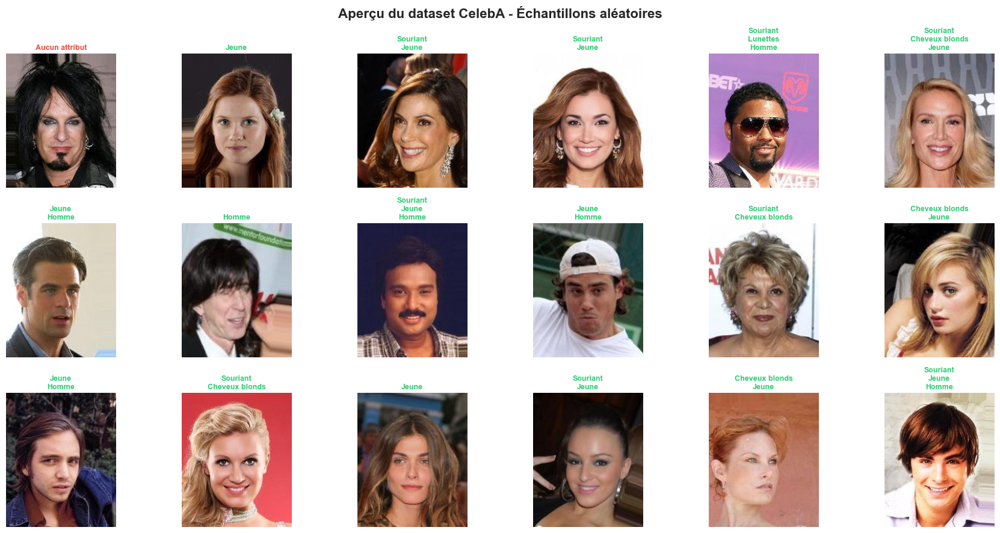


📈 STATISTIQUES DESCRIPTIVES

📊 Distribution des attributs (nombre d'images) :
  Souriant             :  97,669 (48.21%)
  Lunettes             :  13,193 ( 6.51%)
  Cheveux blonds       :  29,983 (14.80%)
  Jeune                : 156,734 (77.36%)
  Homme                :  84,434 (41.68%)

📉 Statistiques :
  Nombre moyen d'attributs par image : 1.89
  Nombre min d'attributs par image   : 0
  Nombre max d'attributs par image   : 5

✅ Graphique sauvegardé : distribution_attributs.png


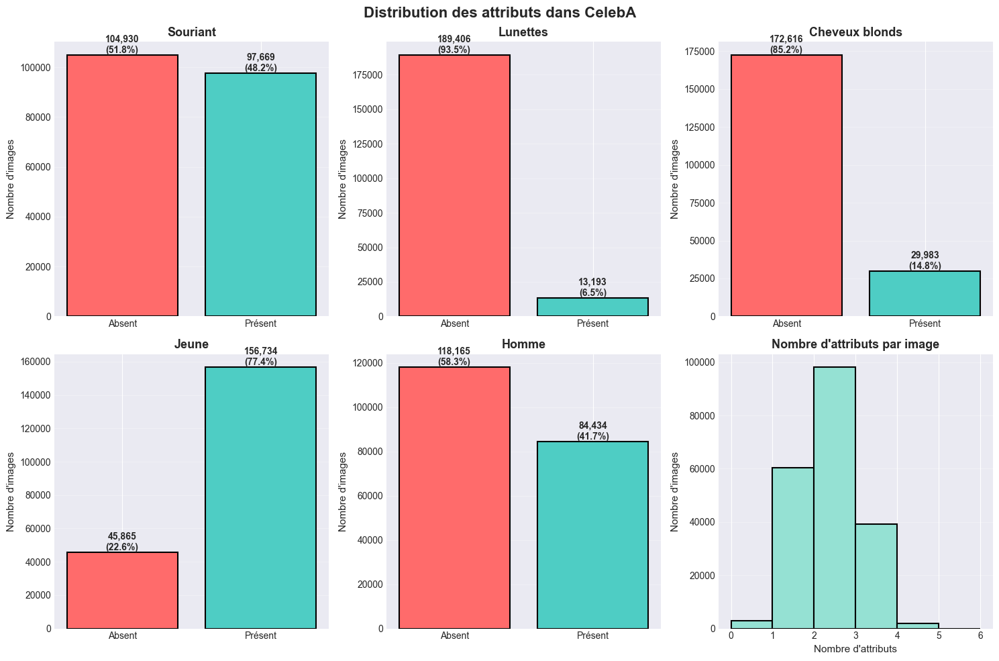


🔗 CORRÉLATIONS ENTRE ATTRIBUTS

✅ Graphique sauvegardé : correlation_matrix.png


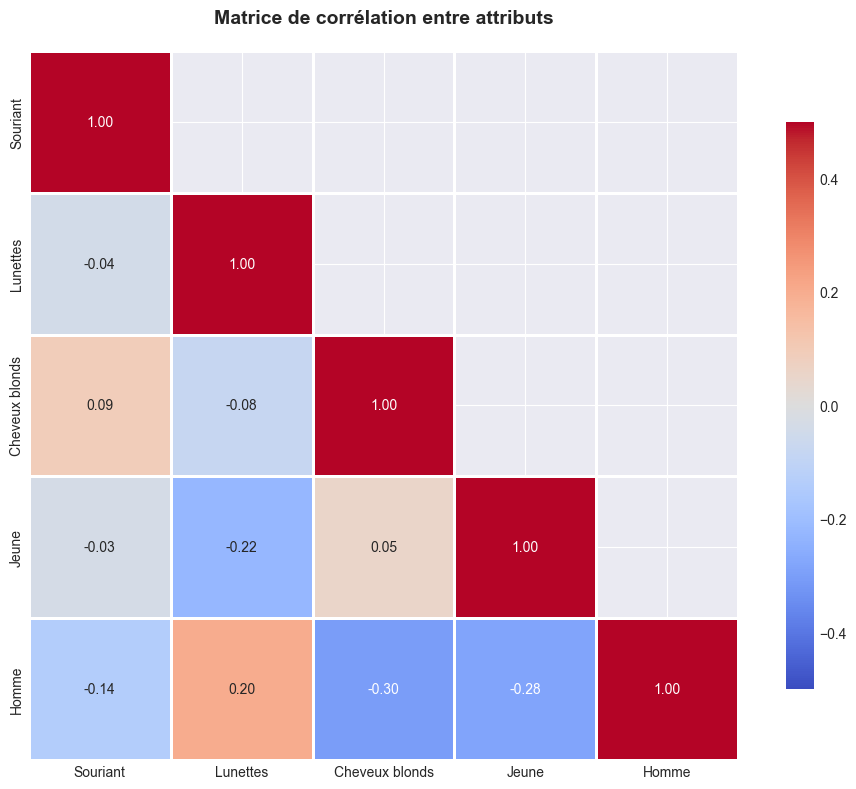


📊 Corrélations les plus fortes :
  Cheveux blonds       ↔ Homme                : -0.303
  Jeune                ↔ Homme                : -0.284
  Lunettes             ↔ Jeune                : -0.225

🎭 COMBINAISONS D'ATTRIBUTS LES PLUS FRÉQUENTES

📋 Top 10 des combinaisons :
   1. [Souriant, Jeune                         ] : 39,468 (19.48%)
   2. [Jeune                                   ] : 38,712 (19.11%)
   3. [Jeune, Homme                            ] : 29,823 (14.72%)
   4. [Souriant, Jeune, Homme                  ] : 18,726 ( 9.24%)
   5. [Homme                                   ] : 13,498 ( 6.66%)
   6. [Souriant, Cheveux blonds, Jeune         ] : 13,494 ( 6.66%)
   7. [Souriant, Homme                         ] : 10,276 ( 5.07%)
   8. [Cheveux blonds, Jeune                   ] :  9,891 ( 4.88%)
   9. [Souriant                                ] :  6,438 ( 3.18%)
  10. [Lunettes, Homme                         ] :  3,851 ( 1.90%)

🖼️ VISUALISATION D'ÉCHANTILLONS PAR ATTRIBUT
✅ Graphi

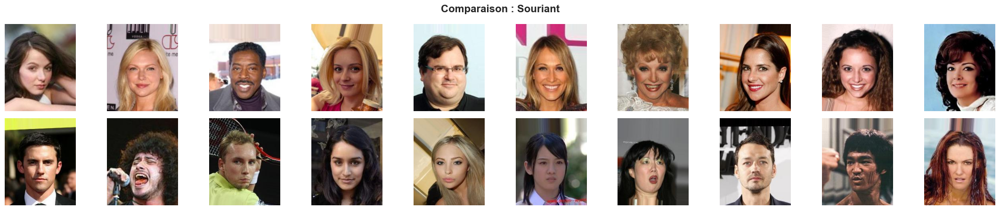

✅ Graphique sauvegardé : samples_eyeglasses.png


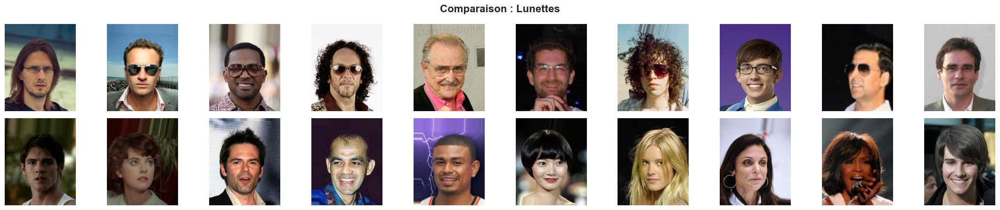

✅ Graphique sauvegardé : samples_blond_hair.png


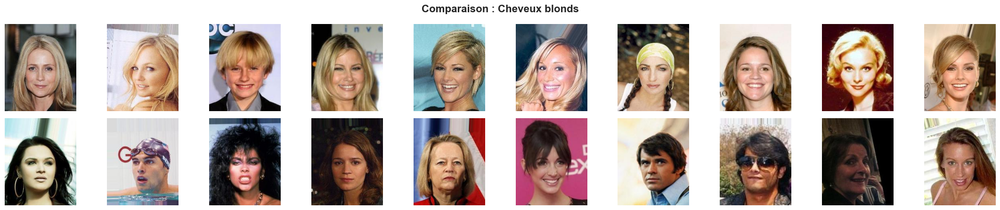

✅ Graphique sauvegardé : samples_young.png


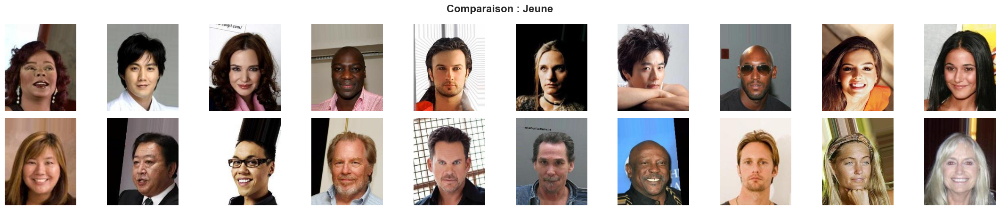

✅ Graphique sauvegardé : samples_male.png


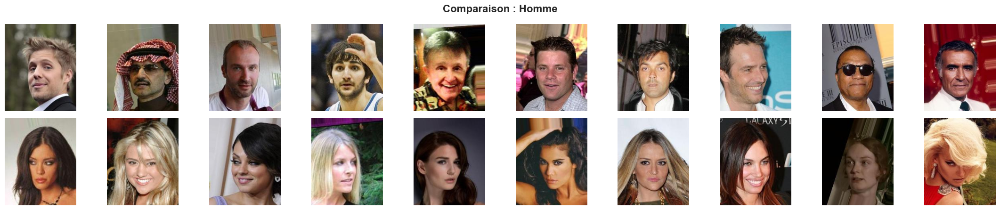


🎭 EXEMPLES DE COMBINAISONS D'ATTRIBUTS

✅ Graphique sauvegardé : combinaisons_specifiques.png


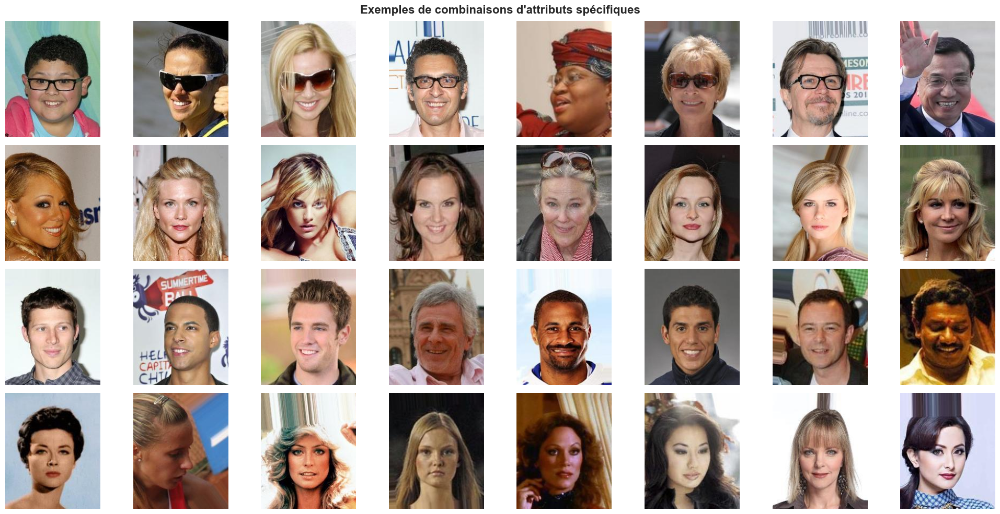


🎲 ÉCHANTILLONS ALÉATOIRES DU DATASET

✅ Graphique sauvegardé : random_samples.png


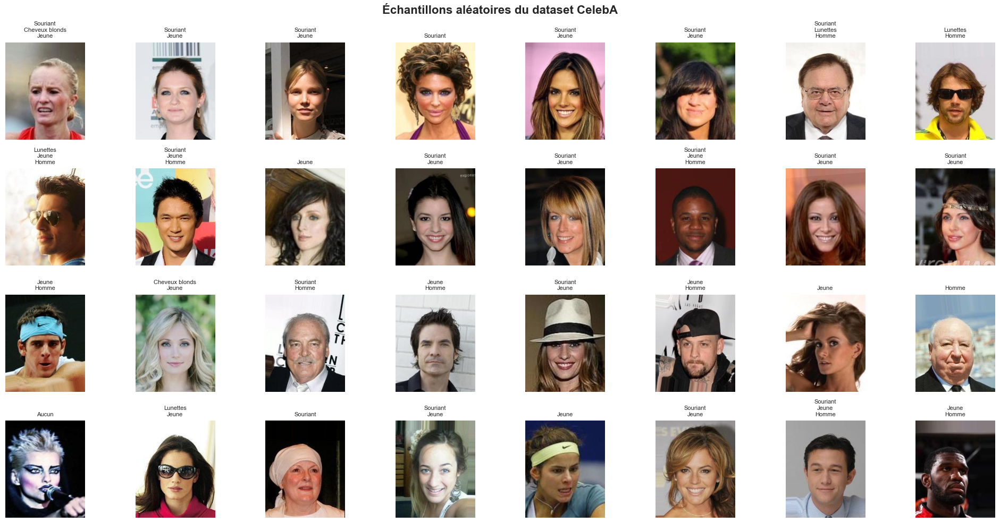


✅ EXPLORATION TERMINÉE

📁 Fichiers générés :
  • apercu_dataset.png
  • distribution_attributs.png
  • correlation_matrix.png
  • samples_smiling.png
  • samples_eyeglasses.png
  • samples_blond_hair.png
  • samples_young.png
  • samples_male.png
  • combinaisons_specifiques.png
  • random_samples.png

 Prêt pour le prétraitement  !


In [27]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from PIL import Image
import random

# Configuration matplotlib
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")

# Chemins (ajustez selon votre configuration)
IMG_DIR = Path("C:/Users/user/datasets/celeba/img_align_celeba/img_align_celeba")
ATTR_FILE = Path("C:/Users/user/datasets/celeba/list_attr_celeba.csv")

# ============================================================================
# 1. CHARGEMENT ET PRÉPARATION DES DONNÉES
# ============================================================================

print("=" * 70)
print("📊 EXPLORATION DU DATASET CELEBA")
print("=" * 70)

# Chargement des annotations
attr_df = pd.read_csv(ATTR_FILE)
print(f"\n✅ Dataset chargé : {len(attr_df):,} images")
print(f"📂 Chemin des images : {IMG_DIR}")

# Attributs sélectionnés
SELECTED_ATTRS = ['Smiling', 'Eyeglasses', 'Blond_Hair', 'Young', 'Male']
ATTR_NAMES_FR = ['Souriant', 'Lunettes', 'Cheveux blonds', 'Jeune', 'Homme']

# Conversion -1/1 à 0/1
for attr in SELECTED_ATTRS:
    if attr_df[attr].min() == -1:
        attr_df[attr] = (attr_df[attr] + 1) // 2

print(f"\n🎯 Attributs sélectionnés : {', '.join(ATTR_NAMES_FR)}")

# ============================================================================
# 2. APERÇU RAPIDE DES IMAGES
# ============================================================================

print("\n" + "=" * 70)
print("🖼️ APERÇU RAPIDE DU DATASET")
print("=" * 70)

fig, axes = plt.subplots(3, 6, figsize=(18, 9))
fig.suptitle('Aperçu du dataset CelebA - Échantillons aléatoires', fontsize=16, fontweight='bold')

random_samples = attr_df.sample(18)
for idx, (_, row) in enumerate(random_samples.iterrows()):
    ax = axes[idx // 6, idx % 6]
    img_path = IMG_DIR / row['image_id']

    if img_path.exists():
        img = Image.open(img_path)
        ax.imshow(img)

        # Labels des attributs présents
        attrs_present = [ATTR_NAMES_FR[i] for i, attr in enumerate(SELECTED_ATTRS) if row[attr] == 1]
        if attrs_present:
            label = '\n'.join(attrs_present[:3])  # Max 3 attributs affichés
            color = '#2ECC71'
        else:
            label = 'Aucun attribut'
            color = '#E74C3C'

        ax.set_title(label, fontsize=9, fontweight='bold', color=color, pad=5)
    else:
        ax.text(0.5, 0.5, 'Image\nmanquante', ha='center', va='center', fontsize=10)

    ax.axis('off')

plt.tight_layout()
plt.savefig('apercu_dataset.png', dpi=300, bbox_inches='tight')
print("\n✅ Aperçu sauvegardé : apercu_dataset.png")
plt.show()

# ============================================================================
# 3. STATISTIQUES DESCRIPTIVES
# ============================================================================

print("\n" + "=" * 70)
print("📈 STATISTIQUES DESCRIPTIVES")
print("=" * 70)

# Distribution des attributs
print("\n📊 Distribution des attributs (nombre d'images) :")
for attr, attr_fr in zip(SELECTED_ATTRS, ATTR_NAMES_FR):
    count = attr_df[attr].sum()
    percentage = (count / len(attr_df)) * 100
    print(f"  {attr_fr:20} : {count:7,} ({percentage:5.2f}%)")

# Statistiques globales
print(f"\n📉 Statistiques :")
print(f"  Nombre moyen d'attributs par image : {attr_df[SELECTED_ATTRS].sum(axis=1).mean():.2f}")
print(f"  Nombre min d'attributs par image   : {attr_df[SELECTED_ATTRS].sum(axis=1).min()}")
print(f"  Nombre max d'attributs par image   : {attr_df[SELECTED_ATTRS].sum(axis=1).max()}")

# ============================================================================
# 4. VISUALISATION - DISTRIBUTION DES ATTRIBUTS
# ============================================================================

fig, axes = plt.subplots(2, 3, figsize=(15, 10))
fig.suptitle('Distribution des attributs dans CelebA', fontsize=16, fontweight='bold')

# Distribution individuelle
for idx, (attr, attr_fr) in enumerate(zip(SELECTED_ATTRS, ATTR_NAMES_FR)):
    ax = axes[idx // 3, idx % 3]
    counts = attr_df[attr].value_counts().sort_index()
    colors = ['#FF6B6B', '#4ECDC4']
    bars = ax.bar(['Absent', 'Présent'], counts.values, color=colors, edgecolor='black', linewidth=1.5)

    # Ajout des pourcentages sur les barres
    for bar in bars:
        height = bar.get_height()
        percentage = (height / len(attr_df)) * 100
        ax.text(bar.get_x() + bar.get_width()/2., height,
                f'{int(height):,}\n({percentage:.1f}%)',
                ha='center', va='bottom', fontweight='bold', fontsize=10)

    ax.set_title(attr_fr, fontsize=13, fontweight='bold')
    ax.set_ylabel('Nombre d\'images', fontsize=11)
    ax.grid(axis='y', alpha=0.3)

# Nombre d'attributs par image
ax = axes[1, 2]
attr_counts = attr_df[SELECTED_ATTRS].sum(axis=1)
ax.hist(attr_counts, bins=range(7), color='#95E1D3', edgecolor='black', linewidth=1.5)
ax.set_title('Nombre d\'attributs par image', fontsize=13, fontweight='bold')
ax.set_xlabel('Nombre d\'attributs', fontsize=11)
ax.set_ylabel('Nombre d\'images', fontsize=11)
ax.grid(axis='y', alpha=0.3)

plt.tight_layout()
plt.savefig('distribution_attributs.png', dpi=300, bbox_inches='tight')
print("\n✅ Graphique sauvegardé : distribution_attributs.png")
plt.show()

# ============================================================================
# 5. MATRICE DE CORRÉLATION
# ============================================================================

print("\n" + "=" * 70)
print("🔗 CORRÉLATIONS ENTRE ATTRIBUTS")
print("=" * 70)

# Calcul de la corrélation
correlation_matrix = attr_df[SELECTED_ATTRS].corr()

# Visualisation
plt.figure(figsize=(10, 8))
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool), k=1)
sns.heatmap(correlation_matrix,
            annot=True,
            fmt='.2f',
            cmap='coolwarm',
            center=0,
            square=True,
            linewidths=2,
            cbar_kws={"shrink": 0.8},
            xticklabels=ATTR_NAMES_FR,
            yticklabels=ATTR_NAMES_FR,
            vmin=-0.5, vmax=0.5,
            mask=mask)

plt.title('Matrice de corrélation entre attributs', fontsize=14, fontweight='bold', pad=20)
plt.tight_layout()
plt.savefig('correlation_matrix.png', dpi=300, bbox_inches='tight')
print("\n✅ Graphique sauvegardé : correlation_matrix.png")
plt.show()

# Corrélations les plus fortes
print("\n📊 Corrélations les plus fortes :")
corr_pairs = []
for i in range(len(SELECTED_ATTRS)):
    for j in range(i+1, len(SELECTED_ATTRS)):
        corr_pairs.append((
            ATTR_NAMES_FR[i],
            ATTR_NAMES_FR[j],
            correlation_matrix.iloc[i, j]
        ))

corr_pairs.sort(key=lambda x: abs(x[2]), reverse=True)
for attr1, attr2, corr in corr_pairs[:3]:
    print(f"  {attr1:20} ↔ {attr2:20} : {corr:+.3f}")

# ============================================================================
# 6. COMBINAISONS D'ATTRIBUTS
# ============================================================================

print("\n" + "=" * 70)
print("🎭 COMBINAISONS D'ATTRIBUTS LES PLUS FRÉQUENTES")
print("=" * 70)

# Création d'une colonne de combinaison avec indices
attr_df['combination_indices'] = attr_df[SELECTED_ATTRS].apply(
    lambda row: '_'.join([str(i) for i, val in enumerate(row) if val == 1]),
    axis=1
)

top_combinations = attr_df['combination_indices'].value_counts().head(10)
print("\n📋 Top 10 des combinaisons :")
for idx, (combo, count) in enumerate(top_combinations.items(), 1):
    if combo:
        indices = [int(i) for i in combo.split('_')]
        combo_fr = ', '.join([ATTR_NAMES_FR[i] for i in indices])
    else:
        combo_fr = 'Aucun attribut'
    percentage = (count / len(attr_df)) * 100
    print(f"  {idx:2}. [{combo_fr:40}] : {count:6,} ({percentage:5.2f}%)")

# ============================================================================
# 7. VISUALISATION D'ÉCHANTILLONS PAR ATTRIBUT
# ============================================================================

print("\n" + "=" * 70)
print("🖼️ VISUALISATION D'ÉCHANTILLONS PAR ATTRIBUT")
print("=" * 70)

def show_samples_by_attribute(attr_name, attr_name_fr, n_samples=10):
    """Affiche des échantillons avec et sans un attribut donné"""
    fig, axes = plt.subplots(2, n_samples, figsize=(22, 4.5))
    fig.suptitle(f'Comparaison : {attr_name_fr}', fontsize=16, fontweight='bold')

    # Avec attribut
    with_attr = attr_df[attr_df[attr_name] == 1].sample(n_samples)
    for idx, (_, row) in enumerate(with_attr.iterrows()):
        img_path = IMG_DIR / row['image_id']
        if img_path.exists():
            img = Image.open(img_path)
            axes[0, idx].imshow(img)
            axes[0, idx].axis('off')
            if idx == 0:
                axes[0, idx].set_ylabel(f'✅ Avec\n{attr_name_fr}',
                                       fontsize=11, fontweight='bold',
                                       rotation=0, ha='right', va='center')

    # Sans attribut
    without_attr = attr_df[attr_df[attr_name] == 0].sample(n_samples)
    for idx, (_, row) in enumerate(without_attr.iterrows()):
        img_path = IMG_DIR / row['image_id']
        if img_path.exists():
            img = Image.open(img_path)
            axes[1, idx].imshow(img)
            axes[1, idx].axis('off')
            if idx == 0:
                axes[1, idx].set_ylabel(f'❌ Sans\n{attr_name_fr}',
                                       fontsize=11, fontweight='bold',
                                       rotation=0, ha='right', va='center')

    plt.tight_layout()
    plt.savefig(f'samples_{attr_name.lower()}.png', dpi=300, bbox_inches='tight')
    print(f"✅ Graphique sauvegardé : samples_{attr_name.lower()}.png")
    plt.show()

# Génération pour chaque attribut
for attr, attr_fr in zip(SELECTED_ATTRS, ATTR_NAMES_FR):
    show_samples_by_attribute(attr, attr_fr, n_samples=10)

# ============================================================================
# 8. ÉCHANTILLONS AVEC COMBINAISONS SPÉCIFIQUES
# ============================================================================

print("\n" + "=" * 70)
print("🎭 EXEMPLES DE COMBINAISONS D'ATTRIBUTS")
print("=" * 70)

# Définir des combinaisons intéressantes à visualiser
interesting_combinations = [
    {'Smiling': 1, 'Eyeglasses': 1},
    {'Blond_Hair': 1, 'Young': 1},
    {'Male': 1, 'Smiling': 1},
    {'Eyeglasses': 0, 'Smiling': 0, 'Male': 0},
]

combo_names = [
    'Souriant avec lunettes',
    'Jeune blond(e)',
    'Homme souriant',
    'Sans lunettes, sans sourire, femme'
]

fig, axes = plt.subplots(len(interesting_combinations), 8, figsize=(20, 10))
fig.suptitle('Exemples de combinaisons d\'attributs spécifiques', fontsize=16, fontweight='bold')

for combo_idx, (combo, combo_name) in enumerate(zip(interesting_combinations, combo_names)):
    # Filtrer les images selon la combinaison
    mask = pd.Series([True] * len(attr_df))
    for attr, value in combo.items():
        mask &= (attr_df[attr] == value)

    filtered_df = attr_df[mask]

    if len(filtered_df) >= 8:
        samples = filtered_df.sample(8)
    else:
        samples = filtered_df.sample(min(len(filtered_df), 8))

    for img_idx, (_, row) in enumerate(samples.iterrows()):
        if img_idx >= 8:
            break
        ax = axes[combo_idx, img_idx]
        img_path = IMG_DIR / row['image_id']

        if img_path.exists():
            img = Image.open(img_path)
            ax.imshow(img)

        ax.axis('off')

        if img_idx == 0:
            ax.set_ylabel(f'{combo_name}\n({len(filtered_df):,} images)',
                         fontsize=10, fontweight='bold',
                         rotation=0, ha='right', va='center')

plt.tight_layout()
plt.savefig('combinaisons_specifiques.png', dpi=300, bbox_inches='tight')
print("\n✅ Graphique sauvegardé : combinaisons_specifiques.png")
plt.show()

# ============================================================================
# 9. ÉCHANTILLONS ALÉATOIRES
# ============================================================================

print("\n" + "=" * 70)
print("🎲 ÉCHANTILLONS ALÉATOIRES DU DATASET")
print("=" * 70)

fig, axes = plt.subplots(4, 8, figsize=(20, 10))
fig.suptitle('Échantillons aléatoires du dataset CelebA', fontsize=16, fontweight='bold')

random_samples = attr_df.sample(32)
for idx, (_, row) in enumerate(random_samples.iterrows()):
    ax = axes[idx // 8, idx % 8]
    img_path = IMG_DIR / row['image_id']

    if img_path.exists():
        img = Image.open(img_path)
        ax.imshow(img)

        # Labels des attributs
        attrs_present = [ATTR_NAMES_FR[i] for i, attr in enumerate(SELECTED_ATTRS) if row[attr] == 1]
        label = '\n'.join(attrs_present[:3]) if attrs_present else 'Aucun'
        ax.set_title(label, fontsize=8)

    ax.axis('off')

plt.tight_layout()
plt.savefig('random_samples.png', dpi=300, bbox_inches='tight')
print("\n✅ Graphique sauvegardé : random_samples.png")
plt.show()

# ============================================================================
# 10. RÉSUMÉ FINAL
# ============================================================================

print("\n" + "=" * 70)
print("✅ EXPLORATION TERMINÉE")
print("=" * 70)
print(f"\n📁 Fichiers générés :")
print(f"  • apercu_dataset.png")
print(f"  • distribution_attributs.png")
print(f"  • correlation_matrix.png")
for attr in SELECTED_ATTRS:
    print(f"  • samples_{attr.lower()}.png")
print(f"  • combinaisons_specifiques.png")
print(f"  • random_samples.png")
print(f"\n Prêt pour le prétraitement  !")

🔧 PRÉPARATION DES DONNÉES POUR L'ENTRAÎNEMENT MULTI-TÂCHES

📂 1. CHARGEMENT ET DIVISION DES DONNÉES

✅ Dataset chargé : 202,599 images

📊 Division des données :
  • Entraînement : 141,819 images (70.0%)
  • Validation    :  30,390 images (15.0%)
  • Test          :  30,390 images (15.0%)

📈 Distribution des attributs par ensemble :
  Souriant             | Train: 48.18% | Val: 48.16% | Test: 48.37%
  Lunettes             | Train:  6.53% | Val:  6.30% | Test:  6.66%
  Cheveux blonds       | Train: 14.79% | Val: 14.61% | Test: 15.04%
  Jeune                | Train: 77.38% | Val: 77.61% | Test: 77.01%
  Homme                | Train: 41.73% | Val: 41.69% | Test: 41.39%

🎨 2. DÉFINITION DES TRANSFORMATIONS

✅ Transformations définies :
  • Taille des images : 128x128
  • Entraînement      : Augmentation activée (flip, jitter, rotation)
  • Validation/Test   : Sans augmentation
  • Normalisation     : ImageNet stats

🗂️ 3. CRÉATION DU DATASET PYTORCH

✅ Datasets créés :
  • Train Dataset : 1

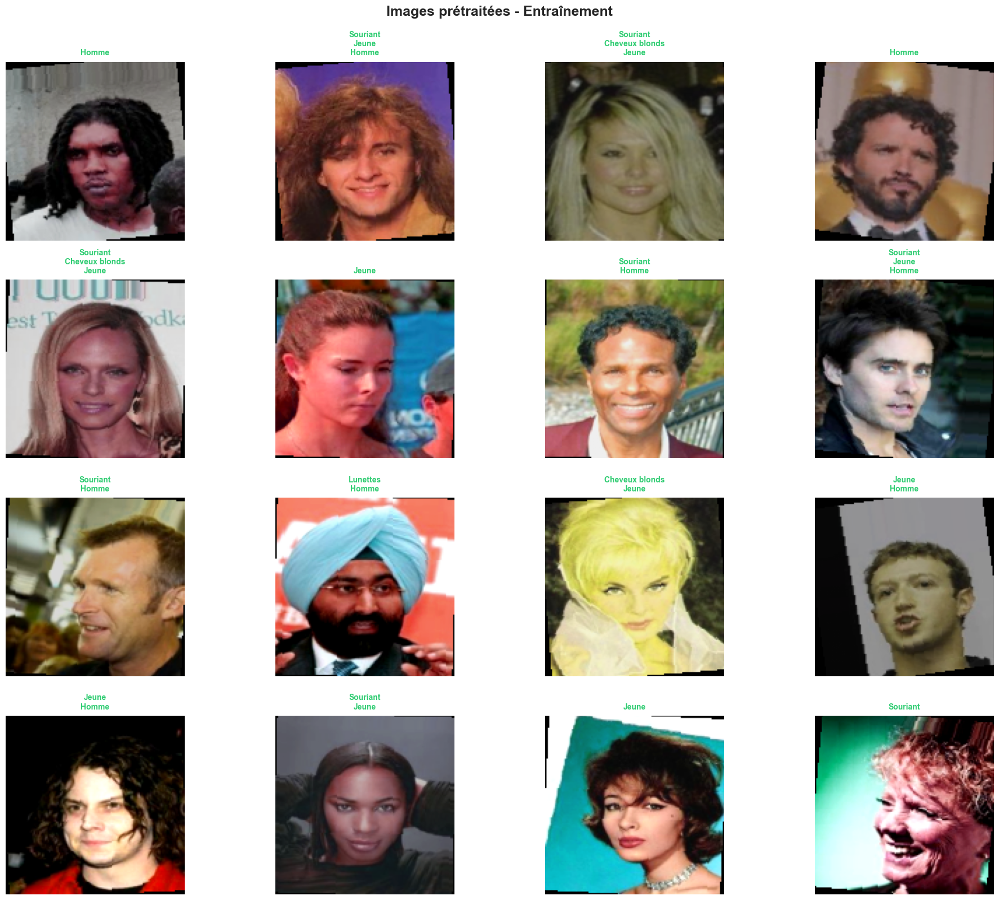

✅ Sauvegardé : preprocessed_validation.png


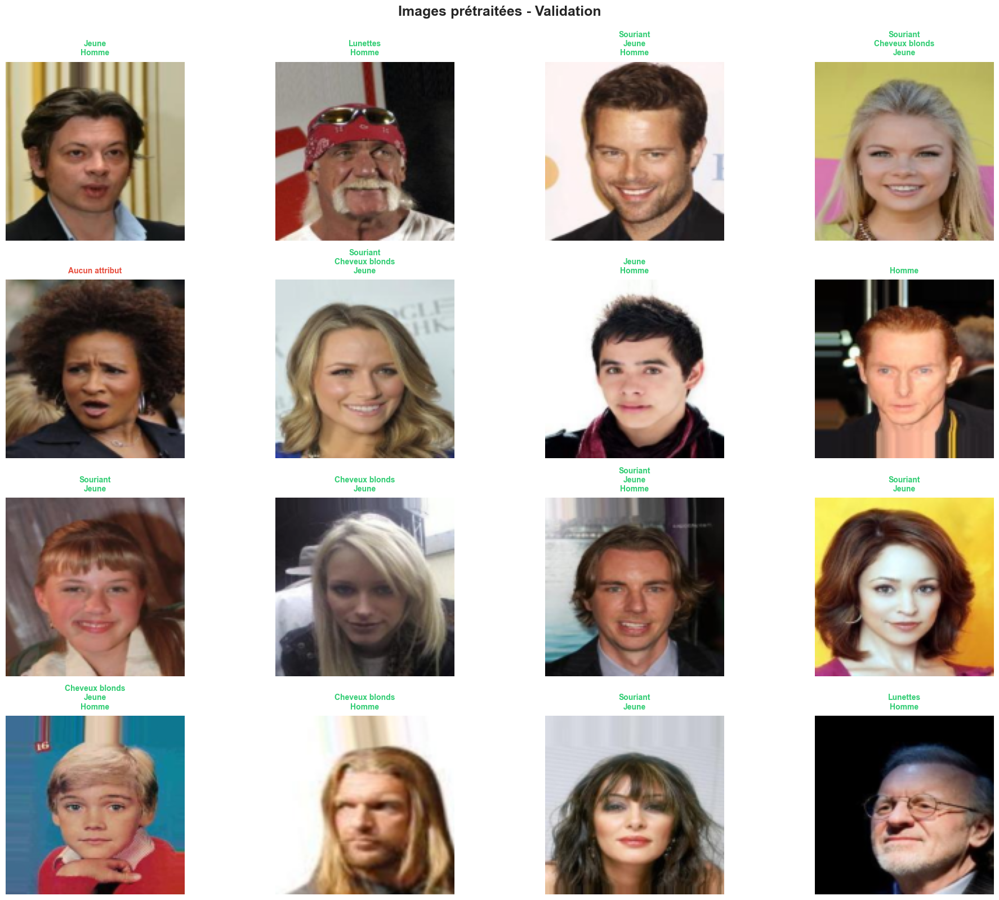

✅ Sauvegardé : preprocessed_test.png


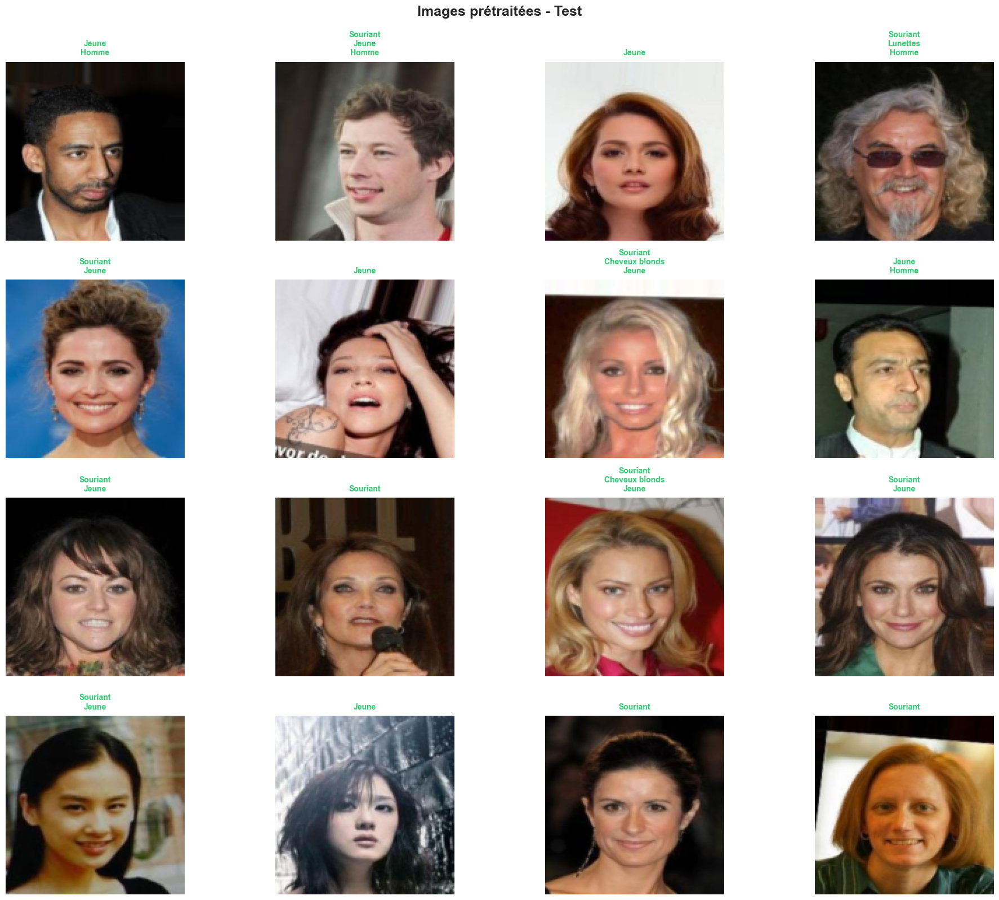

In [29]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from PIL import Image
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import random
from sklearn.model_selection import train_test_split

# Configuration
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")

# Chemins
IMG_DIR = Path("C:/Users/user/datasets/celeba/img_align_celeba/img_align_celeba")
ATTR_FILE = Path("C:/Users/user/datasets/celeba/list_attr_celeba.csv")

# Hyperparamètres
IMG_SIZE = 128  # Taille des images après redimensionnement
BATCH_SIZE = 32
TRAIN_RATIO = 0.7
VAL_RATIO = 0.15
TEST_RATIO = 0.15

# Attributs sélectionnés
SELECTED_ATTRS = ['Smiling', 'Eyeglasses', 'Blond_Hair', 'Young', 'Male']
ATTR_NAMES_FR = ['Souriant', 'Lunettes', 'Cheveux blonds', 'Jeune', 'Homme']

print("=" * 80)
print("🔧 PRÉPARATION DES DONNÉES POUR L'ENTRAÎNEMENT MULTI-TÂCHES")
print("=" * 80)

# ============================================================================
# 1. CHARGEMENT ET DIVISION DES DONNÉES
# ============================================================================

print("\n" + "=" * 80)
print("📂 1. CHARGEMENT ET DIVISION DES DONNÉES")
print("=" * 80)

# Chargement
attr_df = pd.read_csv(ATTR_FILE)
print(f"\n✅ Dataset chargé : {len(attr_df):,} images")

# Conversion -1/1 à 0/1
for attr in SELECTED_ATTRS:
    if attr_df[attr].min() == -1:
        attr_df[attr] = (attr_df[attr] + 1) // 2

# Division train/val/test
train_df, temp_df = train_test_split(attr_df, test_size=(VAL_RATIO + TEST_RATIO), random_state=42)
val_df, test_df = train_test_split(temp_df, test_size=TEST_RATIO/(VAL_RATIO + TEST_RATIO), random_state=42)

print(f"\n📊 Division des données :")
print(f"  • Entraînement : {len(train_df):7,} images ({len(train_df)/len(attr_df)*100:.1f}%)")
print(f"  • Validation    : {len(val_df):7,} images ({len(val_df)/len(attr_df)*100:.1f}%)")
print(f"  • Test          : {len(test_df):7,} images ({len(test_df)/len(attr_df)*100:.1f}%)")

# Vérification de la distribution des attributs
print(f"\n📈 Distribution des attributs par ensemble :")
for attr, attr_fr in zip(SELECTED_ATTRS, ATTR_NAMES_FR):
    train_pct = train_df[attr].mean() * 100
    val_pct = val_df[attr].mean() * 100
    test_pct = test_df[attr].mean() * 100
    print(f"  {attr_fr:20} | Train: {train_pct:5.2f}% | Val: {val_pct:5.2f}% | Test: {test_pct:5.2f}%")

# ============================================================================
# 2. DÉFINITION DES TRANSFORMATIONS
# ============================================================================

print("\n" + "=" * 80)
print("🎨 2. DÉFINITION DES TRANSFORMATIONS")
print("=" * 80)

# Transformations pour l'entraînement (avec augmentation)
train_transforms = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
    transforms.RandomRotation(degrees=10),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Transformations pour validation/test (sans augmentation)
eval_transforms = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

print(f"\n✅ Transformations définies :")
print(f"  • Taille des images : {IMG_SIZE}x{IMG_SIZE}")
print(f"  • Entraînement      : Augmentation activée (flip, jitter, rotation)")
print(f"  • Validation/Test   : Sans augmentation")
print(f"  • Normalisation     : ImageNet stats")

# ============================================================================
# 3. CLASSE DATASET PERSONNALISÉE
# ============================================================================

print("\n" + "=" * 80)
print("🗂️ 3. CRÉATION DU DATASET PYTORCH")
print("=" * 80)

class CelebAMultiTask(Dataset):
    """Dataset CelebA pour apprentissage multi-tâches"""

    def __init__(self, dataframe, img_dir, transform=None):
        self.df = dataframe.reset_index(drop=True)
        self.img_dir = img_dir
        self.transform = transform
        self.attrs = SELECTED_ATTRS

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        # Chargement de l'image
        img_name = self.df.loc[idx, 'image_id']
        img_path = self.img_dir / img_name
        image = Image.open(img_path).convert('RGB')

        # Application des transformations
        if self.transform:
            image = self.transform(image)

        # Labels multi-tâches (un vecteur binaire)
        labels = torch.tensor([self.df.loc[idx, attr] for attr in self.attrs], dtype=torch.float32)

        return image, labels

# Création des datasets
train_dataset = CelebAMultiTask(train_df, IMG_DIR, train_transforms)
val_dataset = CelebAMultiTask(val_df, IMG_DIR, eval_transforms)
test_dataset = CelebAMultiTask(test_df, IMG_DIR, eval_transforms)

print(f"\n✅ Datasets créés :")
print(f"  • Train Dataset : {len(train_dataset):,} échantillons")
print(f"  • Val Dataset   : {len(val_dataset):,} échantillons")
print(f"  • Test Dataset  : {len(test_dataset):,} échantillons")

# Création des dataloaders
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=0)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=0)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=0)

print(f"\n✅ DataLoaders créés :")
print(f"  • Batch size : {BATCH_SIZE}")
print(f"  • Train batches : {len(train_loader):,}")
print(f"  • Val batches   : {len(val_loader):,}")
print(f"  • Test batches  : {len(test_loader):,}")

# ============================================================================
# 4. VISUALISATION DES IMAGES PRÉTRAITÉES
# ============================================================================

print("\n" + "=" * 80)
print("🖼️ 4. VISUALISATION DES IMAGES PRÉTRAITÉES")
print("=" * 80)

def denormalize(tensor):
    """Dénormalise un tenseur pour l'affichage"""
    mean = torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)
    std = torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1)
    tensor = tensor * std + mean
    tensor = torch.clamp(tensor, 0, 1)
    return tensor

def show_batch(dataloader, dataset_name, n_images=16):
    """Affiche un batch d'images prétraitées"""
    # Récupération d'un batch
    images, labels = next(iter(dataloader))

    # Calcul du nombre de lignes et colonnes
    n_rows = 4
    n_cols = n_images // n_rows

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 16))
    fig.suptitle(f'Images prétraitées - {dataset_name}', fontsize=18, fontweight='bold', y=0.995)

    for idx in range(min(n_images, len(images))):
        row = idx // n_cols
        col = idx % n_cols
        ax = axes[row, col]

        # Dénormalisation et conversion pour affichage
        img = denormalize(images[idx])
        img_np = img.permute(1, 2, 0).numpy()

        ax.imshow(img_np)

        # Labels
        img_labels = labels[idx].numpy()
        attrs_present = [ATTR_NAMES_FR[i] for i, val in enumerate(img_labels) if val == 1]

        if attrs_present:
            label_text = '\n'.join(attrs_present)
            color = '#2ECC71'
        else:
            label_text = 'Aucun attribut'
            color = '#E74C3C'

        ax.set_title(label_text, fontsize=10, fontweight='bold', color=color, pad=8)
        ax.axis('off')

    plt.tight_layout()
    filename = f'preprocessed_{dataset_name.lower()}.png'
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    print(f"✅ Sauvegardé : {filename}")
    plt.show()

# Visualisation pour chaque ensemble
print("\n📸 Génération des visualisations...")
show_batch(train_loader, "Entraînement")
show_batch(val_loader, "Validation")
show_batch(test_loader, "Test")


🔄 5. COMPARAISON AVANT/APRÈS PRÉTRAITEMENT

✅ Sauvegardé : comparison_before_after.png


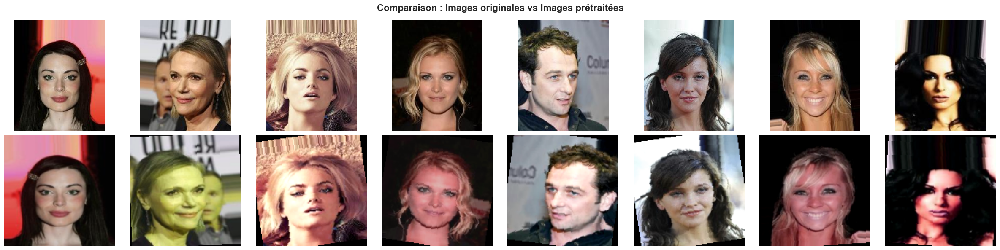


📊 6. STATISTIQUES DES DONNÉES PRÉTRAITÉES

🔢 Format des données :
  • Shape des images : torch.Size([32, 3, 128, 128])
  • Shape des labels : torch.Size([32, 5])
  • Type des images  : torch.float32
  • Type des labels  : torch.float32

📈 Statistiques des images normalisées :
  • Min value  : -2.1179
  • Max value  : 2.6400
  • Mean value : -0.2642
  • Std value  : 1.2948

🎯 Statistiques des labels :
  • Souriant             : 14/32 ( 43.8%)
  • Lunettes             :  1/32 (  3.1%)
  • Cheveux blonds       :  2/32 (  6.2%)
  • Jeune                : 26/32 ( 81.2%)
  • Homme                : 16/32 ( 50.0%)

📉 7. DISTRIBUTION DES LABELS PAR ENSEMBLE

✅ Sauvegardé : distribution_par_ensemble.png


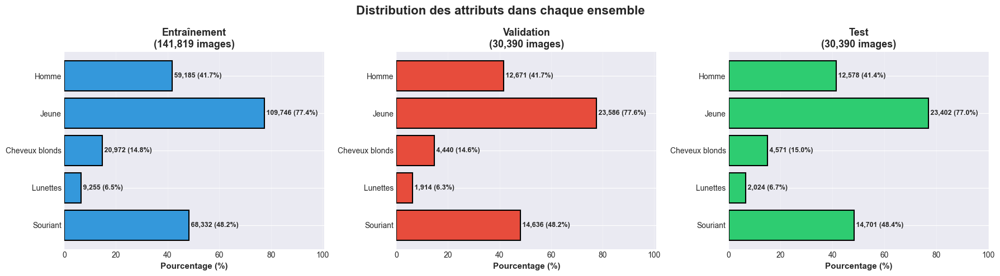


💾 8. SAUVEGARDE DES MÉTADONNÉES

✅ Fichiers CSV sauvegardés :
  • train_split.csv (141,819 lignes)
  • val_split.csv (30,390 lignes)
  • test_split.csv (30,390 lignes)

✅ Métadonnées sauvegardées : preprocessing_metadata.json


In [30]:
# 5. COMPARAISON AVANT/APRÈS PRÉTRAITEMENT
# ============================================================================

print("\n" + "=" * 80)
print("🔄 5. COMPARAISON AVANT/APRÈS PRÉTRAITEMENT")
print("=" * 80)

# Sélectionner quelques échantillons
n_samples = 8
sample_indices = random.sample(range(len(train_df)), n_samples)

fig, axes = plt.subplots(2, n_samples, figsize=(24, 6))
fig.suptitle('Comparaison : Images originales vs Images prétraitées',
             fontsize=16, fontweight='bold')

for idx, sample_idx in enumerate(sample_indices):
    # Image originale
    img_name = train_df.iloc[sample_idx]['image_id']
    img_path = IMG_DIR / img_name
    original_img = Image.open(img_path).convert('RGB')

    axes[0, idx].imshow(original_img)
    axes[0, idx].axis('off')
    if idx == 0:
        axes[0, idx].set_ylabel('Original', fontsize=13, fontweight='bold',
                                rotation=0, ha='right', va='center')

    # Image prétraitée
    preprocessed_img, labels = train_dataset[sample_idx]
    preprocessed_img = denormalize(preprocessed_img)
    preprocessed_np = preprocessed_img.permute(1, 2, 0).numpy()

    axes[1, idx].imshow(preprocessed_np)
    axes[1, idx].axis('off')
    if idx == 0:
        axes[1, idx].set_ylabel('Prétraitée\n(Augmentée)', fontsize=13,
                               fontweight='bold', rotation=0, ha='right', va='center')

    # Labels
    img_labels = labels.numpy()
    attrs_present = [ATTR_NAMES_FR[i] for i, val in enumerate(img_labels) if val == 1]
    label_text = ', '.join(attrs_present[:2]) if attrs_present else 'Aucun'
    axes[1, idx].set_xlabel(label_text, fontsize=9, fontweight='bold')

plt.tight_layout()
plt.savefig('comparison_before_after.png', dpi=300, bbox_inches='tight')
print("\n✅ Sauvegardé : comparison_before_after.png")
plt.show()

# ============================================================================
# 6. STATISTIQUES DES DONNÉES PRÉTRAITÉES
# ============================================================================

print("\n" + "=" * 80)
print("📊 6. STATISTIQUES DES DONNÉES PRÉTRAITÉES")
print("=" * 80)

# Calcul des statistiques sur un batch
sample_images, sample_labels = next(iter(train_loader))

print(f"\n🔢 Format des données :")
print(f"  • Shape des images : {sample_images.shape}")
print(f"  • Shape des labels : {sample_labels.shape}")
print(f"  • Type des images  : {sample_images.dtype}")
print(f"  • Type des labels  : {sample_labels.dtype}")

print(f"\n📈 Statistiques des images normalisées :")
print(f"  • Min value  : {sample_images.min():.4f}")
print(f"  • Max value  : {sample_images.max():.4f}")
print(f"  • Mean value : {sample_images.mean():.4f}")
print(f"  • Std value  : {sample_images.std():.4f}")

print(f"\n🎯 Statistiques des labels :")
for i, attr_fr in enumerate(ATTR_NAMES_FR):
    count = sample_labels[:, i].sum().item()
    percentage = (count / len(sample_labels)) * 100
    print(f"  • {attr_fr:20} : {int(count):2}/{len(sample_labels)} ({percentage:5.1f}%)")

# ============================================================================
# 7. DISTRIBUTION DES LABELS DANS CHAQUE ENSEMBLE
# ============================================================================

print("\n" + "=" * 80)
print("📉 7. DISTRIBUTION DES LABELS PAR ENSEMBLE")
print("=" * 80)

fig, axes = plt.subplots(1, 3, figsize=(18, 5))
fig.suptitle('Distribution des attributs dans chaque ensemble',
             fontsize=16, fontweight='bold')

datasets_info = [
    (train_df, 'Entraînement', '#3498DB'),
    (val_df, 'Validation', '#E74C3C'),
    (test_df, 'Test', '#2ECC71')
]

for ax, (df, name, color) in zip(axes, datasets_info):
    counts = [df[attr].sum() for attr in SELECTED_ATTRS]
    percentages = [(c / len(df)) * 100 for c in counts]

    bars = ax.barh(ATTR_NAMES_FR, percentages, color=color, edgecolor='black', linewidth=1.5)

    # Ajout des valeurs sur les barres
    for bar, count, pct in zip(bars, counts, percentages):
        width = bar.get_width()
        ax.text(width, bar.get_y() + bar.get_height()/2,
                f' {int(count):,} ({pct:.1f}%)',
                ha='left', va='center', fontweight='bold', fontsize=9)

    ax.set_xlabel('Pourcentage (%)', fontsize=11, fontweight='bold')
    ax.set_title(f'{name}\n({len(df):,} images)', fontsize=13, fontweight='bold')
    ax.set_xlim(0, max(percentages) * 1.3)
    ax.grid(axis='x', alpha=0.3)

plt.tight_layout()
plt.savefig('distribution_par_ensemble.png', dpi=300, bbox_inches='tight')
print("\n✅ Sauvegardé : distribution_par_ensemble.png")
plt.show()

# ============================================================================
# 8. SAUVEGARDE DES INFORMATIONS
# ============================================================================

print("\n" + "=" * 80)
print("💾 8. SAUVEGARDE DES MÉTADONNÉES")
print("=" * 80)

# Sauvegarde des splits
train_df.to_csv('train_split.csv', index=False)
val_df.to_csv('val_split.csv', index=False)
test_df.to_csv('test_split.csv', index=False)

print(f"\n✅ Fichiers CSV sauvegardés :")
print(f"  • train_split.csv ({len(train_df):,} lignes)")
print(f"  • val_split.csv ({len(val_df):,} lignes)")
print(f"  • test_split.csv ({len(test_df):,} lignes)")

# Sauvegarde des métadonnées
metadata = {
    'img_size': IMG_SIZE,
    'batch_size': BATCH_SIZE,
    'n_attributes': len(SELECTED_ATTRS),
    'attributes': SELECTED_ATTRS,
    'attributes_fr': ATTR_NAMES_FR,
    'train_samples': len(train_df),
    'val_samples': len(val_df),
    'test_samples': len(test_df),
    'normalization_mean': [0.485, 0.456, 0.406],
    'normalization_std': [0.229, 0.224, 0.225]
}

import json
with open('preprocessing_metadata.json', 'w') as f:
    json.dump(metadata, f, indent=4)

print(f"\n✅ Métadonnées sauvegardées : preprocessing_metadata.json")


In [31]:
# 9. RÉSUMÉ FINAL
# ============================================================================

print("\n" + "=" * 80)
print("✅ PRÉPARATION DES DONNÉES TERMINÉE")
print("=" * 80)

print(f"\n📋 Résumé de la préparation :")
print(f"  • Total d'images        : {len(attr_df):,}")
print(f"  • Images d'entraînement : {len(train_df):,}")
print(f"  • Images de validation  : {len(val_df):,}")
print(f"  • Images de test        : {len(test_df):,}")
print(f"  • Taille des images     : {IMG_SIZE}x{IMG_SIZE}")
print(f"  • Nombre d'attributs    : {len(SELECTED_ATTRS)}")
print(f"  • Batch size            : {BATCH_SIZE}")

print(f"\n📁 Fichiers générés :")
print(f"  • preprocessed_entraînement.png")
print(f"  • preprocessed_validation.png")
print(f"  • preprocessed_test.png")
print(f"  • comparison_before_after.png")
print(f"  • distribution_par_ensemble.png")
print(f"  • train_split.csv")
print(f"  • val_split.csv")
print(f"  • test_split.csv")
print(f"  • preprocessing_metadata.json")

print(f"\n🚀 Prêt pour l'entraînement du modèle multi-tâches !")
print(f"\n💡 Prochaines étapes :")
print(f"  1. Définir l'architecture du modèle multi-tâches")
print(f"  2. Configurer la fonction de perte multi-tâches")
print(f"  3. Lancer l'entraînement")
print(f"  4. Évaluer les performances par attribut")
print("=" * 80)


✅ PRÉPARATION DES DONNÉES TERMINÉE

📋 Résumé de la préparation :
  • Total d'images        : 202,599
  • Images d'entraînement : 141,819
  • Images de validation  : 30,390
  • Images de test        : 30,390
  • Taille des images     : 128x128
  • Nombre d'attributs    : 5
  • Batch size            : 32

📁 Fichiers générés :
  • preprocessed_entraînement.png
  • preprocessed_validation.png
  • preprocessed_test.png
  • comparison_before_after.png
  • distribution_par_ensemble.png
  • train_split.csv
  • val_split.csv
  • test_split.csv
  • preprocessing_metadata.json

🚀 Prêt pour l'entraînement du modèle multi-tâches !

💡 Prochaines étapes :
  1. Définir l'architecture du modèle multi-tâches
  2. Configurer la fonction de perte multi-tâches
  3. Lancer l'entraînement
  4. Évaluer les performances par attribut


In [ ]:
# ============================================================================
# SCRIPT COMPLET D'ENTRAÎNEMENT MULTI-TÂCHES - CELEBA (OPTIMISÉ POUR RTX A500)
# ============================================================================

# ============================================================================
# 1. IMPORTS
# ============================================================================

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import models, transforms
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from PIL import Image
from tqdm import tqdm
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_recall_fscore_support, roc_auc_score
import warnings
warnings.filterwarnings('ignore')

print("✅ Tous les modules importés avec succès !")

# ============================================================================
# 2. CONFIGURATION OPTIMISÉE POUR RTX A500
# ============================================================================

# Device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"\n🖥️ Device utilisé : {device}")
if torch.cuda.is_available():
    print(f"   GPU : {torch.cuda.get_device_name(0)}")
    print(f"   Mémoire disponible : {torch.cuda.get_device_properties(0).total_memory / 1e9:.2f} GB")

# Chemins
IMG_DIR = Path("C:/Users/user/datasets/celeba/img_align_celeba/img_align_celeba")
ATTR_FILE = Path("C:/Users/user/datasets/celeba/list_attr_celeba.csv")

# Hyperparamètres OPTIMISÉS pour RTX A500 4GB
IMG_SIZE = 128
BATCH_SIZE = 32
NUM_WORKERS = 0  # Critical for Windows + small GPU
NUM_EPOCHS = 10
LEARNING_RATE = 0.001

# Attributs
SELECTED_ATTRS = ['Smiling', 'Eyeglasses', 'Blond_Hair', 'Young', 'Male']
ATTR_NAMES_FR = ['Souriant', 'Lunettes', 'Cheveux blonds', 'Jeune', 'Homme']

print(f"\n⚙️ Configuration OPTIMISÉE pour RTX A500 :")
print(f"   Taille images  : {IMG_SIZE}x{IMG_SIZE}")
print(f"   Batch size     : {BATCH_SIZE}")
print(f"   Num workers    : {NUM_WORKERS}")
print(f"   Époques        : {NUM_EPOCHS}")
print(f"   Learning rate  : {LEARNING_RATE}")
print(f"   Attributs      : {len(SELECTED_ATTRS)}")

# ============================================================================
# 3. DATASET PYTORCH
# ============================================================================

class CelebAMultiTask(Dataset):
    """Dataset CelebA pour apprentissage multi-tâches"""

    def __init__(self, dataframe, img_dir, transform=None):
        self.df = dataframe.reset_index(drop=True)
        self.img_dir = img_dir
        self.transform = transform
        self.attrs = SELECTED_ATTRS

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        img_name = self.df.loc[idx, 'image_id']
        img_path = self.img_dir / img_name
        image = Image.open(img_path).convert('RGB')

        if self.transform:
            image = self.transform(image)

        labels = torch.tensor([self.df.loc[idx, attr] for attr in self.attrs], dtype=torch.float32)
        return image, labels

# ============================================================================
# 4. MODÈLE MULTI-TÂCHES OPTIMISÉ (4x PLUS LÉGER)
# ============================================================================

class MultiTaskResNetOptimized(nn.Module):
    """Modèle multi-tâches OPTIMISÉ basé sur ResNet50 (outputs logits, no sigmoid)"""

    def __init__(self, num_tasks=5, pretrained=True, dropout_shared=0.5, dropout_heads=0.3):
        super(MultiTaskResNetOptimized, self).__init__()

        # Backbone ResNet50
        resnet = models.resnet50(pretrained=pretrained)
        self.backbone = nn.Sequential(*list(resnet.children())[:-1])

        # Geler le backbone
        for param in self.backbone.parameters():
            param.requires_grad = False

        # Couches partagées OPTIMISÉES (2048 → 256)
        self.shared_layers = nn.Sequential(
            nn.Flatten(),
            nn.Linear(2048, 256),
            nn.BatchNorm1d(256),
            nn.ReLU(),
            nn.Dropout(dropout_shared)
        )

        # Têtes spécifiques: output logits (NO SIGMOID!)
        self.task_heads = nn.ModuleList([
            nn.Sequential(
                nn.Linear(256, 64),
                nn.BatchNorm1d(64),
                nn.ReLU(),
                nn.Dropout(dropout_heads),
                nn.Linear(64, 1)
                # ⚠️ NO SIGMOID HERE ⚠️
            ) for _ in range(num_tasks)
        ])

        self.num_tasks = num_tasks

    def forward(self, x):
        x = self.backbone(x)
        shared = self.shared_layers(x)
        outputs = [head(shared) for head in self.task_heads]
        return torch.cat(outputs, dim=1)  # shape: (B, num_tasks)

    def unfreeze_backbone(self, num_layers=None):
        if num_layers is None:
            for param in self.backbone.parameters():
                param.requires_grad = True
        else:
            layers = list(self.backbone.children())
            for layer in layers[-num_layers:]:
                for param in layer.parameters():
                    param.requires_grad = True

    def get_trainable_params(self):
        return sum(p.numel() for p in self.parameters() if p.requires_grad)

# ============================================================================
# 5. FONCTION DE PERTE (SAFE FOR AUTOCast)
# ============================================================================

class MultiTaskLoss(nn.Module):
    def __init__(self, task_weights=None):
        super(MultiTaskLoss, self).__init__()
        self.task_weights = torch.tensor(
            task_weights if task_weights is not None else [1.0] * 5
        )
        # ✅ BCEWithLogitsLoss: stable with autocast
        self.criterion = nn.BCEWithLogitsLoss(reduction='none')

    def forward(self, logits, targets):
        self.task_weights = self.task_weights.to(logits.device)
        losses = self.criterion(logits, targets)  # logits: raw, targets: 0/1
        task_losses = losses.mean(dim=0)
        weighted_loss = (task_losses * self.task_weights).sum()
        return weighted_loss, task_losses

# ============================================================================
# 6. MÉTRIQUES (APPLY SIGMOID MANUALLY)
# ============================================================================

def calculate_metrics(logits, targets, threshold=0.5):
    # Convert logits to probabilities safely
    logits = np.clip(logits, -25, 25)  # prevent overflow in exp()
    predictions = 1 / (1 + np.exp(-logits))  # sigmoid

    num_tasks = predictions.shape[1]
    metrics = {}

    for task_idx in range(num_tasks):
        pred = (predictions[:, task_idx] >= threshold).astype(int)
        true = targets[:, task_idx].astype(int)

        acc = accuracy_score(true, pred)
        precision, recall, f1, _ = precision_recall_fscore_support(
            true, pred, average='binary', zero_division=0
        )

        try:
            auc = roc_auc_score(true, predictions[:, task_idx])
        except:
            auc = 0.0

        metrics[ATTR_NAMES_FR[task_idx]] = {
            'accuracy': acc,
            'precision': precision,
            'recall': recall,
            'f1': f1,
            'auc': auc
        }

    return metrics

# ============================================================================
# 7. ENTRAÎNEMENT OPTIMISÉ
# ============================================================================

# (We'll use the manual loop in main(), so train_epoch/validate_epoch removed for simplicity)
# But you can keep them if preferred — the main logic is in main() below.

# ============================================================================
# 8. SCRIPT PRINCIPAL – VERSION “RTX A500 4 GB”
# ============================================================================

def main():
    print("\n" + "=" * 80)
    print("🚀 DÉBUT DU PIPELINE COMPLET (VERSION RTX A500 4 GB)")
    print("=" * 80)

    # ------------------------------------------------------------------ data
    print("\n📂 Chargement des données...")
    attr_df = pd.read_csv(ATTR_FILE)
    for attr in SELECTED_ATTRS:
        attr_df[attr] = (attr_df[attr] + 1) // 2  # –1 → 0, +1 → 1
    train_df, temp_df = train_test_split(attr_df, test_size=0.3, random_state=42)
    val_df, test_df = train_test_split(temp_df, test_size=0.5, random_state=42)

    # ------------------------------------------------------------------ transforms
    train_transforms = transforms.Compose([
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])
    eval_transforms = transforms.Compose([
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])

    # ------------------------------------------------------------------ datasets / loaders
    train_dataset = CelebAMultiTask(train_df, IMG_DIR, train_transforms)
    val_dataset = CelebAMultiTask(val_df, IMG_DIR, eval_transforms)
    test_dataset = CelebAMultiTask(test_df, IMG_DIR, eval_transforms)

    train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE,
                              shuffle=True, num_workers=NUM_WORKERS,
                              pin_memory=True, persistent_workers=False)
    val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE,
                            shuffle=False, num_workers=NUM_WORKERS,
                            pin_memory=True, persistent_workers=False)
    test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE,
                             shuffle=False, num_workers=NUM_WORKERS,
                             pin_memory=True, persistent_workers=False)

    # ------------------------------------------------------------------ modèle
    print("\n🏗️  Création du modèle ultra-léger...")
    model = MultiTaskResNetOptimized(num_tasks=len(SELECTED_ATTRS), pretrained=True)

    # Geler encore plus de couches
    for layer in list(model.backbone.children())[:-3]:
        for p in layer.parameters():
            p.requires_grad = False

    model = model.to(device)
    print(f"✅ Paramètres entraînables : {model.get_trainable_params():,}")

    # ------------------------------------------------------------------ loss / opti / scheduler
    criterion = MultiTaskLoss()
    optimizer = optim.AdamW(model.parameters(), lr=1e-3, weight_decay=1e-2)
    scheduler = optim.lr_scheduler.OneCycleLR(optimizer, max_lr=5e-3,
                                              steps_per_epoch=len(train_loader),
                                              epochs=NUM_EPOCHS)
    scaler = torch.cuda.amp.GradScaler()

    # ------------------------------------------------------------------ boucle
    history = {'train_loss': [], 'val_loss': [], 'train_metrics': [], 'val_metrics': []}
    best_val_loss, patience_counter = np.inf, 0

    for epoch in range(NUM_EPOCHS):
        print(f"\n📅 Époque {epoch+1}/{NUM_EPOCHS}")

        # ------------------------------------------------------ train
        model.train()
        running_loss = 0.0
        all_pred_logits, all_true = [], []

        pbar = tqdm(train_loader, desc="train", leave=False, dynamic_ncols=True)
        for x, y in pbar:
            x, y = x.to(device, non_blocking=True), y.to(device, non_blocking=True)

            optimizer.zero_grad(set_to_none=True)

            with torch.cuda.amp.autocast():
                logits = model(x)
                loss, _ = criterion(logits, y)

            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()
            scheduler.step()

            running_loss += loss.item()
            all_pred_logits.append(logits.detach().cpu().numpy())
            all_true.append(y.cpu().numpy())
            pbar.set_postfix(loss=f"{loss.item():.4f}")

        train_loss = running_loss / len(train_loader)
        train_metrics = calculate_metrics(np.vstack(all_pred_logits), np.vstack(all_true))

        # ------------------------------------------------------ val
        model.eval()
        running_loss = 0.0
        all_pred_logits, all_true = [], []

        with torch.no_grad():
            pbar = tqdm(val_loader, desc="val  ", leave=False, dynamic_ncols=True)
            for x, y in pbar:
                x, y = x.to(device, non_blocking=True), y.to(device, non_blocking=True)
                with torch.cuda.amp.autocast():
                    logits = model(x)
                    loss, _ = criterion(logits, y)

                running_loss += loss.item()
                all_pred_logits.append(logits.cpu().numpy())
                all_true.append(y.cpu().numpy())
                pbar.set_postfix(loss=f"{loss.item():.4f}")

        val_loss = running_loss / len(val_loader)
        val_metrics = calculate_metrics(np.vstack(all_pred_logits), np.vstack(all_true))

        # ------------------------------------------------------ logging
        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['train_metrics'].append(train_metrics)
        history['val_metrics'].append(val_metrics)

        avg_train_acc = np.mean([m['accuracy'] for m in train_metrics.values()])
        avg_val_acc = np.mean([m['accuracy'] for m in val_metrics.values()])
        print(f"Loss - Train: {train_loss:.4f} | Val: {val_loss:.4f}")
        print(f"Acc  - Train: {avg_train_acc:.4f} | Val: {avg_val_acc:.4f}")
        print(f"LR   - {scheduler.get_last_lr()[0]:.6f}")

        # ------------------------------------------------------ early-stop
        if val_loss < best_val_loss:
            best_val_loss, patience_counter = val_loss, 0
            torch.save(model.state_dict(), "best_model_a500.pth")
            print("✅ Meilleur modèle sauvegardé")
        else:
            patience_counter += 1
            if patience_counter >= 5:  # Reduced patience
                print("⚠️  Early stopping")
                break

        torch.cuda.empty_cache()

    # ------------------------------------------------------------------ test
    print("\n📊 Test set...")
    model.load_state_dict(torch.load("best_model_a500.pth", map_location=device))
    model.eval()
    with torch.no_grad():
        all_pred_logits, all_true = [], []
        for x, y in tqdm(test_loader, desc="test", leave=False):
            x, y = x.to(device), y.to(device)
            with torch.cuda.amp.autocast():
                logits = model(x)
            all_pred_logits.append(logits.cpu().numpy())
            all_true.append(y.cpu().numpy())

    test_metrics = calculate_metrics(np.vstack(all_pred_logits), np.vstack(all_true))

    print(f"\n🎯 RÉSULTATS TEST :")
    for name, m in zip(ATTR_NAMES_FR, test_metrics.values()):
        print(f"   {name:15} | Acc: {m['accuracy']:.3f} | F1: {m['f1']:.3f} | AUC: {m['auc']:.3f}")

    return model, history, test_metrics


if __name__ == "__main__":
    model, history, test_metrics = main()

✅ Tous les modules importés avec succès !

🖥️ Device utilisé : cuda
   GPU : NVIDIA RTX A500 Laptop GPU
   Mémoire disponible : 4.29 GB

⚙️ Configuration OPTIMISÉE pour RTX A500 :
   Taille images  : 128x128
   Batch size     : 32
   Num workers    : 0
   Époques        : 10
   Learning rate  : 0.001
   Attributs      : 5

🚀 DÉBUT DU PIPELINE COMPLET (VERSION RTX A500 4 GB)

📂 Chargement des données...

🏗️  Création du modèle ultra-léger...
✅ Paramètres entraînables : 608,261

📅 Époque 1/10


train:   1%|          | 25/4432 [00:22<1:05:01,  1.13it/s, loss=3.0316]

In [2]:
# ============================================================================
# REPRISE DE L'ENTRAÎNEMENT À PARTIR DE L'ÉPOQUE 3 (CelebA - RTX A500)
# ============================================================================

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import models, transforms
import numpy as np
import pandas as pd
from pathlib import Path
from PIL import Image
from tqdm import tqdm
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_recall_fscore_support, roc_auc_score
import warnings
warnings.filterwarnings('ignore')

# ============================================================================
# CONFIGURATION
# ============================================================================

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"🖥️  Device : {device}")

IMG_DIR = Path("C:/Users/user/datasets/celeba/img_align_celeba/img_align_celeba")
ATTR_FILE = Path("C:/Users/user/datasets/celeba/list_attr_celeba.csv")

IMG_SIZE = 128
BATCH_SIZE = 32
NUM_WORKERS = 0  # Garder à 0 pour stabilité
NUM_EPOCHS = 10
SELECTED_ATTRS = ['Smiling', 'Eyeglasses', 'Blond_Hair', 'Young', 'Male']
ATTR_NAMES_FR = ['Souriant', 'Lunettes', 'Cheveux blonds', 'Jeune', 'Homme']

# ============================================================================
# DATASET
# ============================================================================

class CelebAMultiTask(Dataset):
    def __init__(self, dataframe, img_dir, transform=None):
        self.df = dataframe.reset_index(drop=True)
        self.img_dir = img_dir
        self.transform = transform
        self.attrs = SELECTED_ATTRS

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        img_name = self.df.loc[idx, 'image_id']
        img_path = self.img_dir / img_name
        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        labels = torch.tensor([self.df.loc[idx, attr] for attr in self.attrs], dtype=torch.float32)
        return image, labels

# ============================================================================
# MODÈLE (identique à l'original)
# ============================================================================

class MultiTaskResNetOptimized(nn.Module):
    def __init__(self, num_tasks=5, pretrained=True, dropout_shared=0.5, dropout_heads=0.3):
        super().__init__()
        resnet = models.resnet50(pretrained=pretrained)
        self.backbone = nn.Sequential(*list(resnet.children())[:-1])
        for param in self.backbone.parameters():
            param.requires_grad = False

        self.shared_layers = nn.Sequential(
            nn.Flatten(),
            nn.Linear(2048, 256),
            nn.BatchNorm1d(256),
            nn.ReLU(),
            nn.Dropout(dropout_shared)
        )

        # ⚠️ Identique à l'original : avec BatchNorm1d
        self.task_heads = nn.ModuleList([
            nn.Sequential(
                nn.Linear(256, 64),
                nn.BatchNorm1d(64),      # ← OBLIGATOIRE pour charger le .pth
                nn.ReLU(),
                nn.Dropout(dropout_heads),
                nn.Linear(64, 1)
            ) for _ in range(num_tasks)
        ])
        self.num_tasks = num_tasks

    def forward(self, x):
        x = self.backbone(x)
        shared = self.shared_layers(x)
        outputs = [head(shared) for head in self.task_heads]
        return torch.cat(outputs, dim=1)

    def get_trainable_params(self):
        return sum(p.numel() for p in self.parameters() if p.requires_grad)

    def forward(self, x):
        x = self.backbone(x)
        shared = self.shared_layers(x)
        outputs = [head(shared) for head in self.task_heads]
        return torch.cat(outputs, dim=1)

    def get_trainable_params(self):
        return sum(p.numel() for p in self.parameters() if p.requires_grad)

# ============================================================================
# FONCTION DE PERTE
# ============================================================================

class MultiTaskLoss(nn.Module):
    def __init__(self, task_weights=None):
        super().__init__()
        self.task_weights = torch.tensor(task_weights if task_weights is not None else [1.0] * 5)
        self.criterion = nn.BCEWithLogitsLoss(reduction='none')

    def forward(self, logits, targets):
        self.task_weights = self.task_weights.to(logits.device)
        losses = self.criterion(logits, targets)
        task_losses = losses.mean(dim=0)
        weighted_loss = (task_losses * self.task_weights).sum()
        return weighted_loss, task_losses

# ============================================================================
# MÉTRIQUES
# ============================================================================

def calculate_metrics(logits, targets, threshold=0.5):
    logits = np.clip(logits, -25, 25)
    predictions = 1 / (1 + np.exp(-logits))
    num_tasks = predictions.shape[1]
    metrics = {}
    for task_idx in range(num_tasks):
        pred = (predictions[:, task_idx] >= threshold).astype(int)
        true = targets[:, task_idx].astype(int)
        acc = accuracy_score(true, pred)
        precision, recall, f1, _ = precision_recall_fscore_support(true, pred, average='binary', zero_division=0)
        try:
            auc = roc_auc_score(true, predictions[:, task_idx])
        except:
            auc = 0.0
        metrics[ATTR_NAMES_FR[task_idx]] = {'accuracy': acc, 'precision': precision, 'recall': recall, 'f1': f1, 'auc': auc}
    return metrics

# ============================================================================
# FONCTION PRINCIPALE DE REPRISE
# ============================================================================

def resume_training():
    print("📂 Chargement des données...")
    attr_df = pd.read_csv(ATTR_FILE)
    for attr in SELECTED_ATTRS:
        attr_df[attr] = (attr_df[attr] + 1) // 2
    train_df, temp_df = train_test_split(attr_df, test_size=0.3, random_state=42)
    val_df, test_df = train_test_split(temp_df, test_size=0.5, random_state=42)

    train_transforms = transforms.Compose([
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])
    eval_transforms = transforms.Compose([
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])

    train_dataset = CelebAMultiTask(train_df, IMG_DIR, train_transforms)
    val_dataset = CelebAMultiTask(val_df, IMG_DIR, eval_transforms)

    train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS, pin_memory=False)
    val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS, pin_memory=False)

    print("🏗️  Chargement du modèle sauvegardé (après époque 2)...")
    model = MultiTaskResNetOptimized(num_tasks=len(SELECTED_ATTRS), pretrained=False)  # pas besoin de pretrained=True maintenant
    model.load_state_dict(torch.load("best_model_a500.pth", map_location=device))
    model = model.to(device)
    print(f"✅ Modèle chargé. Paramètres entraînables : {model.get_trainable_params():,}")

    # Recréer optimiseur et scheduler
    criterion = MultiTaskLoss()
    optimizer = optim.AdamW(model.parameters(), lr=1e-3, weight_decay=1e-2)
    scheduler = optim.lr_scheduler.OneCycleLR(
        optimizer,
        max_lr=5e-3,
        steps_per_epoch=len(train_loader),
        epochs=NUM_EPOCHS,
        last_epoch=2  # ⚠️ Commence après 2 époques déjà faites
    )
    scaler = torch.cuda.amp.GradScaler()

    # Reprendre à l'époque 3 (index = 2)
    START_EPOCH = 3
    BEST_VAL_LOSS = 1.3013  # val_loss à la fin de l'époque 2

    print(f"\n▶️  Reprise de l'entraînement à l'époque {START_EPOCH}/{NUM_EPOCHS}")
    print(f"   Meilleure val_loss précédente : {BEST_VAL_LOSS:.4f}")

    for epoch in range(START_EPOCH - 1, NUM_EPOCHS):  # epoch index: 2 → 9
        print(f"\n📅 Époque {epoch+1}/{NUM_EPOCHS}")

        # --- Entraînement ---
        model.train()
        running_loss = 0.0
        all_logits, all_targets = [], []

        pbar = tqdm(train_loader, desc="train", leave=False)
        for x, y in pbar:
            x, y = x.to(device, non_blocking=False), y.to(device, non_blocking=False)
            optimizer.zero_grad(set_to_none=True)

            with torch.cuda.amp.autocast():
                logits = model(x)
                loss, _ = criterion(logits, y)

            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()
            scheduler.step()

            running_loss += loss.item()
            all_logits.append(logits.detach().cpu().numpy())
            all_targets.append(y.cpu().numpy())
            pbar.set_postfix(loss=f"{loss.item():.4f}")

        train_loss = running_loss / len(train_loader)
        train_metrics = calculate_metrics(np.vstack(all_logits), np.vstack(all_targets))

        # --- Validation ---
        model.eval()
        running_loss = 0.0
        all_logits, all_targets = [], []

        with torch.no_grad():
            pbar = tqdm(val_loader, desc="val", leave=False)
            for x, y in pbar:
                x, y = x.to(device, non_blocking=False), y.to(device, non_blocking=False)
                with torch.cuda.amp.autocast():
                    logits = model(x)
                    loss, _ = criterion(logits, y)
                running_loss += loss.item()
                all_logits.append(logits.cpu().numpy())
                all_targets.append(y.cpu().numpy())
                pbar.set_postfix(loss=f"{loss.item():.4f}")

        val_loss = running_loss / len(val_loader)
        val_metrics = calculate_metrics(np.vstack(all_logits), np.vstack(all_targets))

        # --- Logs ---
        avg_train_acc = np.mean([m['accuracy'] for m in train_metrics.values()])
        avg_val_acc = np.mean([m['accuracy'] for m in val_metrics.values()])
        print(f"Loss - Train: {train_loss:.4f} | Val: {val_loss:.4f}")
        print(f"Acc  - Train: {avg_train_acc:.4f} | Val: {avg_val_acc:.4f}")
        print(f"LR   - {scheduler.get_last_lr()[0]:.6f}")

        # --- Sauvegarde si meilleur ---
        if val_loss < BEST_VAL_LOSS:
            BEST_VAL_LOSS = val_loss
            torch.save(model.state_dict(), "best_model_a500.pth")
            print("✅ Meilleur modèle sauvegardé")

        torch.cuda.empty_cache()

    print("\n🎉 Entraînement terminé !")

if __name__ == "__main__":
    resume_training()

🖥️  Device : cuda
📂 Chargement des données...
🏗️  Chargement du modèle sauvegardé (après époque 2)...
✅ Modèle chargé. Paramètres entraînables : 608,261


KeyError: "param 'initial_lr' is not specified in param_groups[0] when resuming an optimizer"